# Economic Factors

1. Employment Variation Rate (emp.var.rate)
    - measures the change in the employment rate over a quarterly period.
    - tells us how the job market is doing, positive value implies improving employment situation while the opposite is true if negative.
    - a positive emp.var.rate may correlate with higher spending and a greater likelihood to subscribe to term deposit.
    - the opposite is true for a negative emp.var.rate.

2. Consumer Price Index (cons.price.idx)
    - the average change in prices paid by consumers for goods and services monthly (inflation or deflation tracker).
    - an increasing cpi means inflation meaning less buying power for the consumer and probably less likely to subscribe to the term deposit (this is true in most cases).
    - the opposite is true (in most cases).

3. Consumer Confidence Index (cons.conf.idx)
    - tells us how the consumer is feeling about the economy, including financial health and spending/investing.
    - high cons.conf.idx will likely lead to higher term deposit subscription as they are more willing to invest.
    - the opposite is true. 

4. Euribor 3-Month Rate (euribor3m)
    - The interest rate European banks lend to each other for a period of 3 months.
    - high euribor3m rate could make term deposit more attractive as banks may offer higher interest rates on the deposits. This is not always the case be higher borrowing cost means less money for certain clients.
    - the opposite is true. 

A positive economic outlook (e.g., rising employment, stable prices, high consumer confidence) can drive higher subscription rates.  
A negative outlook might require targeting clients more likely to subscribe despite economic uncertainty (e.g., risk-averse individuals who value guaranteed returns).

In [1]:
# packages
import pandas as pd
import numpy as np
from dataprep.eda import create_report
import warnings

warnings.filterwarnings("ignore")

import plotly.express as px
from statsmodels.stats.proportion import proportions_ztest
from scipy.stats import chi2_contingency, skew

import seaborn as sns
import matplotlib.pyplot as plt
import scipy.stats as stats

import plotly.figure_factory as ff

from sklearn.model_selection import (
    train_test_split,
    StratifiedKFold,
    RandomizedSearchCV,
    ParameterGrid,
)
from sklearn.metrics import (
    recall_score,
    precision_score,
    classification_report,
    accuracy_score,
    roc_auc_score,
    roc_curve,
    f1_score,
)
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier, StackingClassifier, IsolationForest
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.compose import ColumnTransformer
from imblearn.over_sampling import SMOTE
from sklearn.impute import KNNImputer
from sklearn.decomposition import PCA

np.random.seed(42)

  0%|          | 0/2866 [00:00<?, ?it/s]


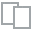
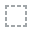
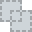
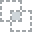
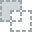
...
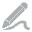
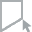
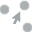
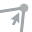
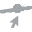

In [93]:
df = pd.read_csv("term deposit data.csv", sep=";")
create_report(df).show()

# Inital EDA: 
- there's 41,188 rows of data
- 20 features, one target
- no missing values 
- 88.73% of people said no to the subscription and 11.27% said yes (imbalanced classes)
- majority of people called are married (~60%)
- average is roughly 40 yrs old
- admin, blue-collar and technician make up roughly 64% of the clients
- most client have some kind of higher education (~65%)
- most client have no personal loans (~82%)
- most client are contacted by cell (~64%)
- most clients were contacted during months of may-aug (~78%)
- days of the week isn't an impact on the subscription likely a feature to drop
- most calls are under 5 mins (~72%)
- During this campaign most clients were contacted between 1 to 2 times (~69%)
- This campaign is mostly targeting clients never been contacted rather than previously contacted clients
- most client don't have a credit in default, this feature isn't really tell us anything it might be best to drop it -- 79.12% say no, 20.87% are unknown and 0.01% are yes.  
- similar story can be said about pdays 
- much of the economic features are strongly correlated with each other, meaning feature selection will need to happen to select the best one.

# Potential Business Objective
The business objective is to expand the customer base for term deposits by targeting a large pool of first-time contacts, maximizing the identification of potential subscribers through the marketing campaign. The focus is on improving subscription rates among new clients while maintaining efficiency in resource allocation, ensuring a balance between growth and campaign effectiveness.


# metric focus
- Primary: Recall (ensure you don’t miss too many potential "yes" clients).  
- Secondary: Precision (focus on correct "yes" predictions).

Given the trend in the data, the campaign aims to grow the subscription base and maximize coverage among new clients, recall should be the primary metric, with precision as a secondary consideration.

In [94]:
print(df.groupby(["default"])["y"].value_counts())


# Counts of successes (subscriptions)


subscriptions = [443, 4197]


# Total counts for each group


totals = [8154 + 443, 4197 + 28391]


# Perform two-proportion Z-test


z_stat, p_value = proportions_ztest(count=subscriptions, nobs=totals)


print(f"Z-Statistic: {z_stat:.2f}, P-Value: {p_value:.4f}")


# Interpret results


if p_value < 0.05:

    print("Statistically significant difference between the two groups.")
else:

    print("No statistically significant difference between the two groups.")

# Contingency table (rows: "unknown" and "no"; columns: "yes" and "no")
contingency_table = [[28391, 4197], [8154, 443], [3, 0]]  # "unknown"  # "no"

# Perform chi-square test
chi2, p_value, dof, expected = chi2_contingency(contingency_table)

print(f"Chi-Square Statistic: {chi2:.2f}, P-Value: {p_value:.4f}")

# Interpret results
if p_value < 0.05:
    print("Statistically significant association between default and subscription.")
else:
    print("No statistically significant association between default and subscription.")

default  y  
no       no     28391
         yes     4197
unknown  no      8154
         yes      443
yes      no         3
Name: y, dtype: int64
Z-Statistic: -20.15, P-Value: 0.0000
Statistically significant difference between the two groups.
Chi-Square Statistic: 406.58, P-Value: 0.0000
Statistically significant association between default and subscription.


In [95]:
df_melted = (
    df.groupby(["y", "default"])["default"]
    .agg({"count"})
    .sort_values("count", ascending=False)
    .reset_index()
)
df_melted["percentage"] = df_melted.groupby(["default"])["count"].apply(
    lambda x: x / x.sum() * 100
)
fig = px.bar(
    df_melted,
    x="default",
    y="count",
    color="y",
    barmode="group",
    title="default Distribution by Subscription",
    text=df_melted["percentage"].apply(lambda x: f"{x:.2f}%"),
)
fig.show()

The majority of clients who said "no" to defaulting on a loan did not subscribe, but there is a small fraction who did.
Clients with "unknown" default status have a lower subscription rate compared to "no," while those with "yes" are negligible.
This suggests default status might not be a strong predictor but "unknown" could indicate uncertainty. There is only 3 clients with default as 'yes' and they chose not subscribe. There are no clients with default as 'yes' and subscription is 'yes'


Binning pdays makes it easier to understand and visualize how recency affects conversion rates by grouping raw values into intuitive categories. The bins clearly show that clients previously contacted more recently are significantly more likely to subscribe when compared to those who were contacted today only. 

In [96]:
bins = [-1, 0, 7, 14, 30, 1000]  # Extend 1000 to capture 999 correctly
labels = ["Today", "Last Week", "Past Two Weeks", "Past Month", "Not Contacted"]
df["pdays_binned"] = pd.cut(df["pdays"], bins=bins, labels=labels)
print(df.groupby(["pdays_binned"])["y"].value_counts())

contingency_table = [
    [10, 5],  # Today
    [764, 398],  # Last Week
    [157, 119],  # Past Two Weeks
    [36, 26],  # Past Month
    [3673, 36000],  # Not Contacted
]

# Perform chi-square test
chi2, p_value, dof, expected = chi2_contingency(contingency_table)

print(f"Chi-Square Statistic: {chi2:.2f}, P-Value: {p_value:.4f}")

# Interpret results
if p_value < 0.05:
    print("Statistically significant association between pdays and subscription.")
else:
    print("No statistically significant association between pdays and subscription.")

pdays_binned    y  
Today           yes       10
                no         5
Last Week       yes      764
                no       398
Past Two Weeks  yes      157
                no       119
Past Month      yes       36
                no        26
Not Contacted   no     36000
                yes     3673
Name: y, dtype: int64
Chi-Square Statistic: 4366.96, P-Value: 0.0000
Statistically significant association between pdays and subscription.


In [99]:
df_melted = (
    df.groupby(["y", "pdays_binned"])["pdays_binned"]
    .agg({"count"})
    .sort_values("count", ascending=False)
    .reset_index()
)
df_melted["percentage"] = df_melted.groupby(["pdays_binned"])["count"].apply(
    lambda x: x / x.sum() * 100
)
fig = px.bar(
    df_melted,
    x="pdays_binned",
    y="count",
    color="y",
    barmode="group",
    title="pdays_binned Distribution by Subscription",
    text=df_melted["percentage"].apply(lambda x: f"{x:.2f}%"),
)
fig.show()

From the above there's statistically significant evidence that the more recently the last call from the financial institution was the more likely the person is to subscribe.

In [100]:
print(df.groupby(["poutcome"])["y"].value_counts())

contingency_table = [
    [605, 3647],  # failure
    [3141, 32422],  # nonexistent
    [894, 479],  # success
]


# Perform chi-square test


chi2, p_value, dof, expected = chi2_contingency(contingency_table)


print(f"Chi-Square Statistic: {chi2:.2f}, P-Value: {p_value:.4f}")


# Interpret results


if p_value < 0.05:

    print("Statistically significant association between poutcome and subscription.")


else:

    print("No statistically significant association between poutcome and subscription.")

poutcome     y  
failure      no      3647
             yes      605
nonexistent  no     32422
             yes     3141
success      yes      894
             no       479
Name: y, dtype: int64
Chi-Square Statistic: 4230.52, P-Value: 0.0000
Statistically significant association between poutcome and subscription.


The data suggests that if you previously contacted a person and they subscribed, they are highly likely to subscribe again. While clients who initially said "no" are slightly more likely to subscribe compared to first-time contacts, the chances remain relatively low. This indicates that developing a rapport with the client, particularly through successful prior interactions, can significantly aid in increasing conversion rates.

In [101]:
print(df.groupby(["poutcome", "previous"])["y"].value_counts())

df_melted = df.groupby(["poutcome", "previous", "y"])["y"].agg({"count"}).reset_index()


df_melted["percentage"] = df_melted.groupby(["poutcome", "previous"])["count"].apply(
    lambda x: x / x.sum() * 100
)


# Create a bar plot with plotly
fig = px.bar(
    df_melted,
    x="previous",
    y="count",
    color="y",
    facet_col="poutcome",
    barmode="group",
    title="Count of Subscription Outcome (y) by Previous Contacts and Poutcome",
    labels={
        "previous": "Number of Previous Contacts",
        "count": "Count",
        "y": "Subscription Outcome",
    },
    text=df_melted["percentage"].apply(lambda x: f"{x:.2f}%"),
)


fig.show()

poutcome     previous  y  
failure      1         no      3245
                       yes      451
             2         no       322
                       yes      112
             3         no        56
                       yes       32
             4         no        21
                       yes        9
             5         no         2
                       yes        1
             6         no         1
nonexistent  0         no     32422
                       yes     3141
success      1         yes      516
                       no       349
             2         yes      238
                       no        82
             3         yes       96
                       no        32
             4         yes       29
                       no        11
             5         yes       12
                       no         3
             6         yes        3
                       no         1
             7         no         1
Name: y, dtype: int64


It appears that as the number of prior contacts increases, clients become more likely to say "yes" or convert to a subscription. However, beyond a certain point, excessive outreach (5+ contacts) leads to diminishing returns and potential client fatigue. The optimal number of prior contacts seems to be 3, where the likelihood of conversion is highest, suggesting that prior engagement is beneficial up to this threshold.

It makes sense to set previous as a categorical variable. There a few unique values, it has a non-linear relationship with y and it is easier to interpret the impact of each group within the category on y.

In [102]:
df["previous"] = pd.Categorical(
    df["previous"], categories=[0, 1, 2, 3, 4, 5, 6, 7], ordered=True
)

for feat in df.select_dtypes(exclude=[np.number]).columns.drop(
    ["y", "poutcome", "previous", "default", "pdays_binned"]
):
    df_melted = (
        df.groupby(["y", feat])[feat]
        .agg({"count"})
        .sort_values("count", ascending=False)
        .reset_index()
    )
    df_melted["percentage"] = df_melted.groupby([feat])["count"].apply(
        lambda x: x / x.sum() * 100
    )
    fig = px.bar(
        df_melted,
        x=feat,
        y="count",
        color="y",
        barmode="group",
        title=f"{feat} Distribution by Subscription",
        text=df_melted["percentage"].apply(lambda x: f"{x:.2f}%"),
    )

    fig.show()

1. Job Distribution by Subscription
Subscription rates appear relatively higher among students, retired individuals, and unemployed clients compared to other job categories.

2. Marital Distribution by Subscription
Married clients account for the majority of "no" outcomes, but single clients have a slightly higher proportion of "yes" outcomes compared to divorced or married individuals. Clients in the "unknown" group rarely subscribed, this may not be a meaningful group.

3. Education Distribution by Subscription
Clients with higher education tend to have higher subscription rates over those with basic education.

4. Housing Distribution by Subscription
Clients with a housing loan are less likely to subscribe compared to those without one.

5. Loan Distribution by Subscription
Clients' loan status is negatively correlated with their subscription likelihood.

6. Contact Distribution by Subscription
Clients contacted via cellular have a significantly higher proportion of subscriptions compared to telephone contacts.

7. Month Distribution by Subscription
Subscription rates seem relatively consistent across months, much like days of the week this may not be a good feature to put in the model as it's not very discriminatory.

8. Day of Week Distribution by Subscription
Subscription outcomes are relatively consistent across all days of the week, with a similar proportion of "yes" and "no."
The day of the week may not significantly impact subscription likelihood. As mentioned before this feature can and will be dropped.

average age of subscribers 40.91
average age of non-subscribers 39.91
average age of clients 40.02


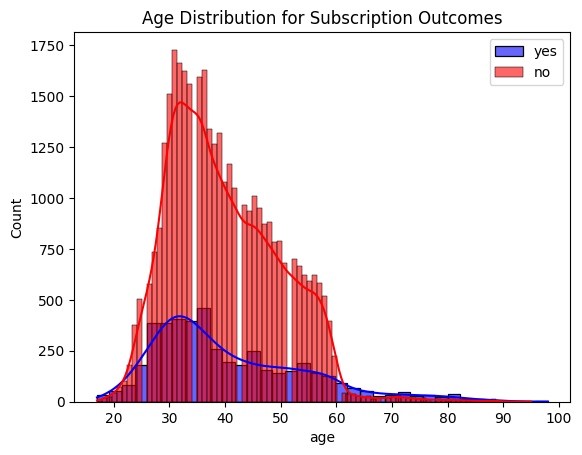

In [200]:
print(
    f'average age of subscribers {df.loc[df["y"] == "yes"]["age"].mean():.2f}\naverage age of non-subscribers {df.loc[df["y"] =="no"]["age"].mean():.2f}\naverage age of clients {df["age"].mean():.2f}'
)


sns.histplot(
    df[df["y"] == "yes"]["age"],
    kde=True,
    label="yes",
    color="blue",
    alpha=0.6,
)


sns.histplot(
    df[df["y"] == "no"]["age"],
    kde=True,
    label="no",
    color="red",
    alpha=0.6,
)
plt.legend()


plt.title("Age Distribution for Subscription Outcomes")


plt.show()


# Define bins and labels
age_bins = [16, 30, 45, 60, 99]  # Adjusted based on density plot
age_labels = [
    "Young (17-30)",
    "Early Adults (31-45)",
    "Middle-Aged (46-60)",
    "Seniors (60+)",
]

# Apply binning to the 'age' column
df["age_binned"] = pd.cut(df["age"], bins=age_bins, labels=age_labels, right=True)

In [104]:
for feat in df.select_dtypes(include=[np.number]).columns.drop(["pdays", "age"]):
    x_yes = df[df["y"] == "yes"][feat]
    x_no = df[df["y"] == "no"][feat]

    fig = ff.create_distplot(
        [x_yes, x_no],
        group_labels=["Yes", "No"],  # Legends for the classes
        show_hist=False,  # Hide the histogram
        show_rug=False,
    )
    fig.update_layout(
        title=f"Density Plot of {feat} by Subscription Outcome (Y)",
        xaxis_title=f"{feat}",
        yaxis_title="Density",
    )
    fig.write_image(f"Density Plot of {feat} by Subscription Outcome.png")
    fig.show()

1. Age
As mentioned above both 'yes' and 'no' have an average of about 40 yrs. However, we do see that those over the age of 60+ are more likely to subscribe than say no. when compared to those between 30-59 yrs of age. Age could be discriminative feature for those 60+.

2. Duration
"Yes" responses tend to have longer call durations, while shorter calls are majority associated with "no" responses. However, because duration is only known after the call is made we can not include it in our model because it will lead to data leakage. If model uses duration to predict y, you would need the duration of the call beforehand. 

3. Campaign
Most responses occur after 1-2 contacts, and both "yes" and "no" responses drops significantly as the number of contacts increases. This implies that the optimal number of contacts is around 1-3. I noticed the right skew of the campaign feature and will adjust this with a boxcox transformation.

4. Employment Variation Rate (emp.var.rate)
Negative employment variation rates are more associated with "yes" responses, while positive rates correlate with "no." Clients may want a safer option for their money during economic uncertainty. The clear separation of densities indicates this is a useful feature for prediction.

5. Consumer Price Index (cons.price.idx)
We have peaks in "no" responses at certain price levels meaning specific price levels are negatively associated with subscriptions. We see that "Yes" responses are less concentrated at these peaks and more spread out. This suggests that clients are less likely to subscribe when the consumer price index is at certain high levels, possibly reflecting economic conditions or reduced purchasing power.

6. Consumer Confidence Index (cons.conf.idx)
Very similar to cpi, clients with a more stable or higher consumer confidence index are more likely to subscribe. The sharp peaks in "no" responses suggest that low confidence is correlated with non-subscription.

7. Euribor 3-Month Rate (euribor3m)
Higher Euribor rates is strongly correlated with "no" responses, suggesting that clients are less likely to subscribe during periods of high borrowing costs. "Yes" responses are concentrated at lower Euribor rates, indicating that favorable financial conditions encourage subscription. This aligns with the economic relationship between lower interest rates and higher investment activity.

8. Number of Employees (nr.employed)
"No" responses are concentrated at higher employee levels while "yes" responses are slightly more concentrated at lower levels.
This suggests that larger employment levels (possibly indicating economic stability) reduce the need for clients to invest in term deposits.


I specifically used models who have capability to handle imbalanced datasets. These models have parameters like class_weight, that can be tuned and optimized to give the minority class more focus.

In [106]:
# Updated Hyperparameter Grids
param_grids = {
    "logistic_regression": {
        "penalty": ["l2"],  # Regularization to avoid overfitting
        "C": [0.01, 0.1, 1, 10, 100],  # Wider range for regularization strength
        "solver": ["liblinear", "lbfgs"],
        "class_weight": ["balanced"],  # Adjust weights for imbalance
    },
    "random_forest": {
        "n_estimators": [100, 200, 300],  # Focus on a smaller range of trees
        "max_depth": [
            10,
            20,
            None,
        ],  # Control overfitting and capture minority patterns
        "min_samples_split": [2, 5, 10],  # Prevent overfitting to noise
        "min_samples_leaf": [1, 2, 4],  # Ensure splits generalize well
        "class_weight": ["balanced", {0: 1, 1: 8}],  # Handle imbalance
    },
    "xgboost": {
        "n_estimators": [100, 200, 300, 500],  # More estimators for complex patterns
        "max_depth": [3, 5, 7, 10, 20],  # Deeper trees for imbalance
        "learning_rate": [0.01, 0.1, 0.2],  # Focus on smaller learning rates
        "scale_pos_weight": [8, 10, 15],  # Balances the positive class weight
        "subsample": [0.8, 1.0],  # Randomly sample training data
        "colsample_bytree": [0.8, 1.0],  # Randomly sample features per tree
    },
    "naive_bayes": {},  # Naive Bayes has no hyperparameters to tune
    "isolation_forest": {
        "n_estimators": [100, 200, 300],  # More estimators for stability
        "max_samples": [0.5, 0.8, 1.0],  # Sampling more data for robust training
        "contamination": [0.05, 0.1, 0.2],  # Tune based on outlier expectations
        "random_state": [42],
    },
}

In [107]:
# features to drop
drop_features = [
    # "age",
    # "pdays",
    "duration",
    "y",
    # "nr.employed",
    # "emp.var.rate",
    # "default",
    # "age_binned",
    # "pdays_binned",
]
potential_drop = ["month", "day_of_week"]
X = df.drop(columns=drop_features)
X["previous"] = X["previous"].astype(int)
y = df["y"].map({"yes": 1, "no": 0})


categorical_cols = X.select_dtypes(include=["object", "category"]).columns
numerical_cols = X.select_dtypes(include=["number"]).columns
X = pd.get_dummies(X, columns=categorical_cols, drop_first=True)
# Train-test split with stratified sampling


# Preprocessing function
def preprocess_data(X, y=None, model_type=None, resample=False, feature_list=[]):
    train = X[0]
    test = X[1]
    train_idx = train.index
    test_idx = test.index
    full_data = pd.concat([train, test])

    preprocessor = ColumnTransformer(
        transformers=[
            (
                "scaler",
                StandardScaler(),
                (
                    [cat for cat in numerical_cols if cat in feature_list]
                    if feature_list
                    else numerical_cols
                ),
            ),
        ],
        remainder="passthrough",
    )
    full_data = pd.DataFrame(preprocessor.fit_transform(full_data))
    return full_data.loc[train_idx], full_data.loc[test_idx]


# Feature selection function
def select_features(model, X_train, y_train, feature_cols, top_n=40):
    """
    Select the top N features based on feature importance from the given model.
    """
    model.fit(X_train, y_train)
    feature_importances = model.feature_importances_
    important_features = pd.DataFrame(
        {"Feature": feature_cols, "Importance": feature_importances}
    ).sort_values(by="Importance", ascending=False)

    print(
        f"Top {len(important_features)} Features:\n",
        important_features.head(len(important_features)),
    )
    fig = px.bar(important_features, x="Feature", y="Importance")
    fig.show()
    selected_features = important_features.head(top_n)["Feature"].tolist()
    y_pred_train = model.predict(X_train)

    recall = recall_score(y_train, y_pred_train, pos_label=1)
    precision = precision_score(y_train, y_pred_train, pos_label=1)
    print(f"Training Recall: {recall:.4f}")
    print(f"Training Precision: {precision:.4f}")
    print(classification_report(y_train, y_pred_train))

    important_features["Cumulative_Importance"] = important_features[
        "Importance"
    ].cumsum()

    # Select features contributing to 95% of total importance
    selected_features_reduced = important_features[
        important_features["Cumulative_Importance"] <= 0.9
    ]["Feature"].tolist()
    print(
        f"{len(selected_features_reduced)} Selected Features: {selected_features_reduced}"
    )
    return selected_features, selected_features_reduced, important_features, model


# Train-test split with stratified sampling
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, stratify=y, random_state=42
)

# Models with imbalance handling
models = {
    "logistic_regression": LogisticRegression(random_state=42, class_weight="balanced"),
    "random_forest": RandomForestClassifier(
        random_state=42, n_jobs=-1, warm_start=True
    ),
    "xgboost": XGBClassifier(
        objective="binary:logistic",
        random_state=42,
        use_label_encoder=False,
        eval_metric="logloss",
        scale_pos_weight=len(y_train[y_train == 0]) / len(y_train[y_train == 1]),
        n_jobs=-1,
    ),
    "naive_bayes": GaussianNB(),
    "isolation_forest": IsolationForest(
        random_state=42,
        contamination=len(y_train[y_train == 1]) / len(y_train),
        n_jobs=-1,
    ),
}


mod = "random_forest"

X_train_bf, X_test_bf = preprocess_data(
    X=[X_train.copy(), X_test.copy()], model_type=mod
)

ros = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = ros.fit_resample(X_train_bf, y_train)


feature_importance_dict = {}

for train_x, train_y, df_name in [
    (X_train_bf, y_train, "regular"),
    (X_train_resampled, y_train_resampled, "oversample"),
]:
    # Feature selection
    print(f"\n--- Feature Selection with {mod} ---")
    top_features, top_features_reduced, important_features, model = select_features(
        models[mod], train_x, train_y, list(X_train.columns)
    )
    feature_importance_dict[df_name] = [
        important_features,
        top_features,
        top_features_reduced,
    ]


--- Feature Selection with random_forest ---
Top 59 Features:
                             Feature  Importance
0                               age    0.202163
1                          campaign    0.125287
7                         euribor3m    0.107711
33                      housing_yes    0.043289
35                         loan_yes    0.031202
20                  marital_married    0.027423
30                  default_unknown    0.027364
46                  day_of_week_mon    0.020116
49                  day_of_week_wed    0.019509
21                   marital_single    0.019483
56  age_binned_Early Adults (31-45)    0.019405
47                  day_of_week_thu    0.019211
9                   job_blue-collar    0.018858
25            education_high.school    0.018850
28      education_university.degree    0.017865
17                   job_technician    0.017528
36                contact_telephone    0.016691
24               education_basic.9y    0.016593
5                    con

Training Recall: 0.9345
Training Precision: 0.9914
              precision    recall  f1-score   support

           0       0.99      1.00      1.00     29238
           1       0.99      0.93      0.96      3712

    accuracy                           0.99     32950
   macro avg       0.99      0.97      0.98     32950
weighted avg       0.99      0.99      0.99     32950

28 Selected Features: ['age', 'campaign', 'euribor3m', 'housing_yes', 'loan_yes', 'marital_married', 'default_unknown', 'day_of_week_mon', 'day_of_week_wed', 'marital_single', 'age_binned_Early Adults (31-45)', 'day_of_week_thu', 'job_blue-collar', 'education_high.school', 'education_university.degree', 'job_technician', 'contact_telephone', 'education_basic.9y', 'cons.price.idx', 'job_services', 'education_professional.course', 'cons.conf.idx', 'day_of_week_tue', 'age_binned_Middle-Aged (46-60)', 'previous', 'job_management', 'education_basic.6y', 'education_unknown']

--- Feature Selection with random_forest ---


Training Recall: 0.6268
Training Precision: 0.9984
              precision    recall  f1-score   support

           0       0.73      1.00      0.84     29238
           1       1.00      0.63      0.77     29238

    accuracy                           0.81     58476
   macro avg       0.86      0.81      0.81     58476
weighted avg       0.86      0.81      0.81     58476

28 Selected Features: ['age', 'campaign', 'euribor3m', 'housing_yes', 'loan_yes', 'marital_married', 'default_unknown', 'day_of_week_mon', 'day_of_week_wed', 'marital_single', 'age_binned_Early Adults (31-45)', 'day_of_week_thu', 'job_blue-collar', 'education_high.school', 'education_university.degree', 'job_technician', 'contact_telephone', 'education_basic.9y', 'cons.price.idx', 'job_services', 'education_professional.course', 'cons.conf.idx', 'day_of_week_tue', 'age_binned_Middle-Aged (46-60)', 'previous', 'job_management', 'education_basic.6y', 'education_unknown']


In [105]:
df[
    ["emp.var.rate", "cons.price.idx", "cons.conf.idx", "euribor3m", "nr.employed"]
].corr()

,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed
emp.var.rate,1.000000,0.775334,0.196041,0.972245,0.906970
cons.price.idx,0.775334,1.000000,0.058986,0.688230,0.522034
cons.conf.idx,0.196041,0.058986,1.000000,0.277686,0.100513
euribor3m,0.972245,0.688230,0.277686,1.000000,0.945154
nr.employed,0.906970,0.522034,0.100513,0.945154,1.000000


nr.employed and emp.var.rate are highly correlated with euribor3m. I'll use pca to create a new feature combining all 3. 


In [108]:
economic_features = ["emp.var.rate", "euribor3m", "nr.employed"]

scaler = StandardScaler()
X_econ_scaled = pd.DataFrame(
    scaler.fit_transform(X[economic_features]), columns=economic_features
)
from sklearn.decomposition import PCA

pca = PCA()
X_economic_pca = pca.fit_transform(X_econ_scaled)

explained_variance = pca.explained_variance_ratio_
cumulative_variance = explained_variance.cumsum()
print("Explained Variance Ratio:", explained_variance)
print("Cumulative Variance:", cumulative_variance)

n_components = (cumulative_variance <= 0.95).sum() + 1
pca = PCA(n_components=n_components)
X_economic_pca = pca.fit_transform(X_economic_pca)

pca_columns = [f"economic_PC{i+1}" for i in range(n_components)]
X_economic_pca_df = pd.DataFrame(X_economic_pca, columns=pca_columns, index=X.index)
X["econ_feat"] = X_economic_pca_df
X.drop(columns=economic_features, inplace=True)

Explained Variance Ratio: [0.96105523 0.03210655 0.00683822]
Cumulative Variance: [0.96105523 0.99316178 1.        ]


In [109]:
# Train-test split with stratified sampling
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, stratify=y, random_state=42
)

# Models with imbalance handling
models = {
    "logistic_regression": LogisticRegression(random_state=42, class_weight="balanced"),
    "random_forest": RandomForestClassifier(
        random_state=42, n_jobs=-1, warm_start=True
    ),
    "xgboost": XGBClassifier(
        objective="binary:logistic",
        random_state=42,
        use_label_encoder=False,
        eval_metric="logloss",
        scale_pos_weight=len(y_train[y_train == 0]) / len(y_train[y_train == 1]),
        n_jobs=-1,
    ),
    "naive_bayes": GaussianNB(),
    "isolation_forest": IsolationForest(
        random_state=42,
        contamination=len(y_train[y_train == 1]) / len(y_train),
        n_jobs=-1,
    ),
}


mod = "random_forest"

X_train_bf, X_test_bf = preprocess_data(
    X=[X_train.copy(), X_test.copy()], model_type=mod, feature_list=list(X.columns)
)

ros = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = ros.fit_resample(X_train_bf, y_train)


feature_importance_dict = {}

for train_x, train_y, df_name in [
    # (X_train_bf, y_train, "regular"),
    (X_train_resampled, y_train_resampled, "oversample"),
]:
    # Feature selection
    print(f"\n--- Feature Selection with {mod} ---")
    top_features, top_features_reduced, important_features, model = select_features(
        models[mod], train_x, train_y, list(X_train.columns)
    )
    feature_importance_dict[df_name] = [
        important_features,
        top_features,
        top_features_reduced,
    ]


--- Feature Selection with random_forest ---
Top 57 Features:
                             Feature  Importance
1                          campaign    0.135761
0                               age    0.095143
56                        econ_feat    0.073874
30                      housing_yes    0.064973
32                         loan_yes    0.048678
27                  default_unknown    0.039798
45                  day_of_week_tue    0.033271
17                  marital_married    0.031119
43                  day_of_week_mon    0.030258
46                  day_of_week_wed    0.029523
44                  day_of_week_thu    0.029019
14                   job_technician    0.024958
5                     cons.conf.idx    0.024224
4                    cons.price.idx    0.023787
53  age_binned_Early Adults (31-45)    0.021084
22            education_high.school    0.020938
25      education_university.degree    0.020169
9                    job_management    0.019687
6                   job_

Training Recall: 0.9933
Training Precision: 0.9975
              precision    recall  f1-score   support

           0       0.99      1.00      1.00     29238
           1       1.00      0.99      1.00     29238

    accuracy                           1.00     58476
   macro avg       1.00      1.00      1.00     58476
weighted avg       1.00      1.00      1.00     58476

27 Selected Features: ['campaign', 'age', 'econ_feat', 'housing_yes', 'loan_yes', 'default_unknown', 'day_of_week_tue', 'marital_married', 'day_of_week_mon', 'day_of_week_wed', 'day_of_week_thu', 'job_technician', 'cons.conf.idx', 'cons.price.idx', 'age_binned_Early Adults (31-45)', 'education_high.school', 'education_university.degree', 'job_management', 'job_blue-collar', 'job_services', 'marital_single', 'education_basic.9y', 'contact_telephone', 'education_professional.course', 'job_entrepreneur', 'education_unknown', 'month_may']


I was expecting pdays to and previous to be up more the list of important features.

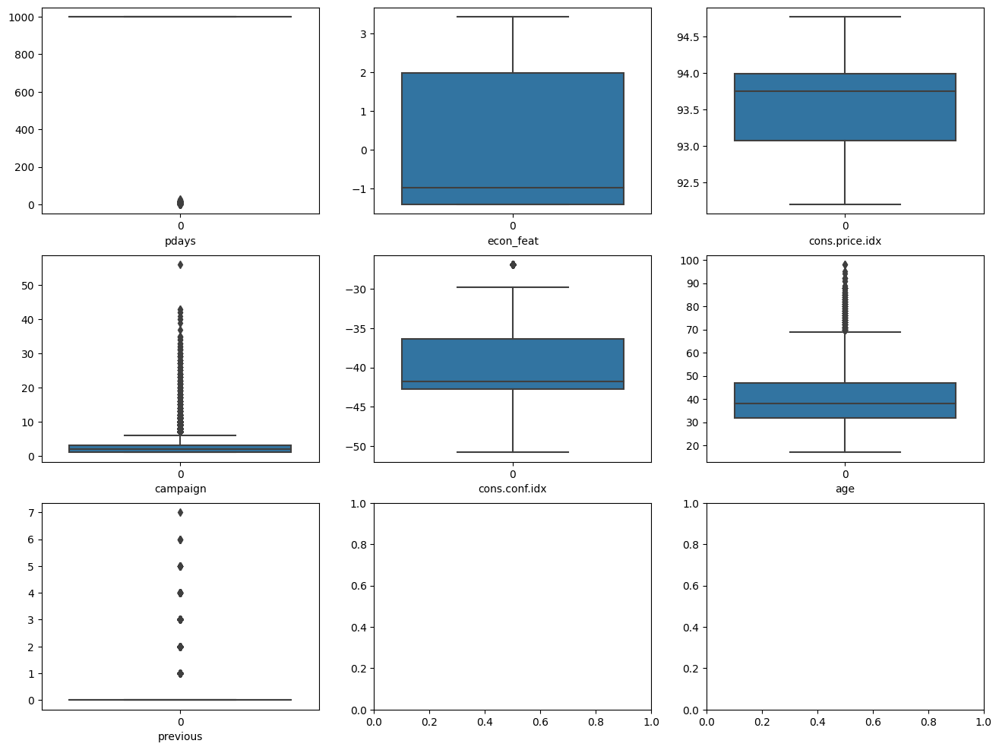

In [110]:
df_copy = pd.concat([X.copy(deep=True), y], axis=1)
df_copy["previous"] = df_copy["previous"].astype(int)


fig, ax = plt.subplots(3, 3, figsize=(16, 12))
ax = ax.ravel()

for i, col in enumerate(
    [
        "pdays",
        "econ_feat",
        "cons.price.idx",
        "campaign",
        "cons.conf.idx",
        "age",
        "previous",
    ]
):
    sns.boxplot(df_copy[col], ax=ax[i])
    ax[i].set_xlabel(col)

df_copy["campaign_cut_7"] = np.where(df_copy.campaign <= 7, 1, 0)

In [116]:
df_cut_7 = df_copy.loc[df_copy["campaign_cut_7"] == 1].copy().reset_index(drop=True)

# Step 3: Select correlated features for imputation
imputation_features = [
    "pdays_numeric",
    "cons.price.idx",
    "campaign",
    "cons.conf.idx",
    "age",
    "previous",
]  # Add other relevant numeric features

for df_i in [df_copy, df_cut_7]:
    df_i["pdays_missing"] = np.where(df_i["pdays"] == 999, 1, 0)
    df_i["pdays_numeric"] = np.where(df_i["pdays"] == 999, np.nan, df_i["pdays"])
    df_i["pdays_med_impute"] = np.where(
        df_i["pdays"] == 999, df_i["pdays_numeric"].median().round(), df_i["pdays"]
    )

    # Step 4: Standardize the features
    scaler = StandardScaler()
    df_scaled = pd.DataFrame(
        scaler.fit_transform(df_i[imputation_features]), columns=imputation_features
    )

    df_scaled["econ_feat"] = df_i["econ_feat"]
    # Step 5: Apply KNN Imputation
    imputer = KNNImputer(n_neighbors=5, weights="uniform")
    df_imputed_scaled = imputer.fit_transform(df_scaled)
    df_imputed_scaled = pd.DataFrame(
        df_imputed_scaled, columns=imputation_features + ["econ_feat"]
    )

    # Step 6: Restore imputed values to the original scale
    df_imputed_knn = pd.DataFrame(
        scaler.inverse_transform(
            df_imputed_scaled[df_imputed_scaled.columns.drop("econ_feat")]
        ),
        columns=imputation_features,
    )
    df_i["pdays_knn_impute"] = df_imputed_knn["pdays_numeric"].round()

    print(df_i.shape)

(41188, 63)
(39411, 63)


In [118]:
for df_i in [df_copy, df_cut_7]:
    for col in ["pdays_med_impute", "pdays_knn_impute"]:
        fig = px.histogram(df_i[col])
        fig.show()

My assumptions when we use the full dataset is KNN imputation is best choice for pdays because it adhere's to the natural right-skewed distribution of pdays which aligns with our initial EDA findings. Median imputation oversimplifies the data causing a lack of variability and the loss of information. 


The distribution of campaign suggests that most clients are called less than 10 times, while distribution of previous suggests that reasonable cutoff for repeated contact is 7. I will confirm via the model performance if clients who received than 7 calls should be included in the modelling data or not.

In [119]:
# features to drop
drop_features = [
    # "age",
    "pdays",
    "pdays_numeric",
    "pdays_med_impute",
    # "duration",
    "y",
    # "nr.employed",
    # "emp.var.rate",
    # "default",
    # "age_binned",
    # "pdays_binned",
]
potential_drop = ["month", "day_of_week"]
X = df_copy.copy()
X = df_copy.drop(columns=drop_features)
X["previous"] = X["previous"].astype(int)
y = df_copy.y
scale_cols = [
    "pdays_knn_impute",
    "cons.price.idx",
    "campaign",
    "cons.conf.idx",
    "age",
    "previous",
]
scaler = StandardScaler()
X[scale_cols] = pd.DataFrame(scaler.fit_transform(X[scale_cols]), columns=scale_cols)
# Train-test split with stratified sampling
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, stratify=y, random_state=42
)


# Models with imbalance handling
models = {
    "logistic_regression": LogisticRegression(random_state=42, class_weight="balanced"),
    "random_forest": RandomForestClassifier(
        random_state=42, n_jobs=-1, warm_start=True
    ),
    "xgboost": XGBClassifier(
        objective="binary:logistic",
        random_state=42,
        use_label_encoder=False,
        eval_metric="logloss",
        scale_pos_weight=len(y_train[y_train == 0]) / len(y_train[y_train == 1]),
        n_jobs=-1,
    ),
    "naive_bayes": GaussianNB(),
    "isolation_forest": IsolationForest(
        random_state=42,
        contamination=len(y_train[y_train == 1]) / len(y_train),
        n_jobs=-1,
    ),
}


mod = "random_forest"

X_train_bf, X_test_bf = X_train.copy(), X_test.copy()

ros = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = ros.fit_resample(X_train_bf, y_train)


feature_importance_dict = {}

for train_x, train_y, df_name in [
    (X_train_bf, y_train, "regular"),
    (X_train_resampled, y_train_resampled, "oversample"),
]:
    # Feature selection
    print(f"\n--- Feature Selection with {mod} ---")
    top_features, top_features_reduced, important_features, model = select_features(
        models[mod], train_x, train_y, list(X_train.columns)
    )
    feature_importance_dict[df_name] = [
        important_features,
        top_features,
        top_features_reduced,
    ]


--- Feature Selection with random_forest ---
Top 59 Features:
                             Feature    Importance
55                        econ_feat  1.344117e-01
0                               age  1.271547e-01
1                          campaign  6.990439e-02
58                 pdays_knn_impute  5.796314e-02
4                     cons.conf.idx  3.852750e-02
29                      housing_yes  3.743159e-02
3                    cons.price.idx  3.076044e-02
51       pdays_binned_Not Contacted  2.562682e-02
31                         loan_yes  2.330040e-02
57                    pdays_missing  1.910112e-02
16                  marital_married  1.909238e-02
48           pdays_binned_Last Week  1.760355e-02
2                          previous  1.745187e-02
45                  day_of_week_wed  1.716538e-02
42                  day_of_week_mon  1.714824e-02
24      education_university.degree  1.712957e-02
13                   job_technician  1.709921e-02
21            education_high.school 

Training Recall: 0.9634
Training Precision: 0.9953
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     29238
           1       1.00      0.96      0.98      3712

    accuracy                           1.00     32950
   macro avg       1.00      0.98      0.99     32950
weighted avg       1.00      1.00      1.00     32950

33 Selected Features: ['econ_feat', 'age', 'campaign', 'pdays_knn_impute', 'cons.conf.idx', 'housing_yes', 'cons.price.idx', 'pdays_binned_Not Contacted', 'loan_yes', 'pdays_missing', 'marital_married', 'pdays_binned_Last Week', 'previous', 'day_of_week_wed', 'day_of_week_mon', 'education_university.degree', 'job_technician', 'education_high.school', 'poutcome_success', 'day_of_week_thu', 'age_binned_Early Adults (31-45)', 'marital_single', 'day_of_week_tue', 'contact_telephone', 'default_unknown', 'job_blue-collar', 'education_basic.9y', 'education_professional.course', 'job_management', 'age_binned_Middle-Aged (4

Training Recall: 0.5450
Training Precision: 0.9989
              precision    recall  f1-score   support

           0       0.69      1.00      0.81     29238
           1       1.00      0.54      0.71     29238

    accuracy                           0.77     58476
   macro avg       0.84      0.77      0.76     58476
weighted avg       0.84      0.77      0.76     58476

33 Selected Features: ['econ_feat', 'age', 'campaign', 'pdays_knn_impute', 'cons.conf.idx', 'housing_yes', 'cons.price.idx', 'pdays_binned_Not Contacted', 'loan_yes', 'pdays_missing', 'marital_married', 'pdays_binned_Last Week', 'previous', 'day_of_week_wed', 'day_of_week_mon', 'education_university.degree', 'job_technician', 'education_high.school', 'poutcome_success', 'day_of_week_thu', 'age_binned_Early Adults (31-45)', 'marital_single', 'day_of_week_tue', 'contact_telephone', 'default_unknown', 'job_blue-collar', 'education_basic.9y', 'education_professional.course', 'job_management', 'age_binned_Middle-Aged (4

In [ ]:
# Cross-validation strategy


cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)


# # Grid search and evaluation


best_models1 = {}


results = []


for train_x, train_y, df_name in [
    (X_train_bf, y_train, "regular"),
    (X_train_resampled, y_train_resampled, "oversample"),
]:

    for feature_list in [
        feature_importance_dict[df_name][1],
        feature_importance_dict[df_name][2],
    ]:

        for name, model in models.items():

            print(f"\nTraining {name}...")

            best_recall = 0

            param_grid = param_grids.get(name, {})

            # Perform grid search for models

            if name == "isolation_forest":

                for params in ParameterGrid(param_grid):

                    model.fit(train_x)

                    # Predictions for train and test

                    y_pred_train = model.predict(train_x)

                    y_pred_test = model.predict(X_test_bf)

                    # Convert predictions (-1: anomaly, 1: inlier) to binary labels (1: yes, 0: no)

                    y_pred_train = (y_pred_train == -1).astype(int)

                    y_pred_test = (y_pred_test == -1).astype(int)

                    # Evaluate on training data

                    recall_train = recall_score(train_y, y_pred_train, pos_label=1)

                    precision_train = precision_score(
                        train_y, y_pred_train, pos_label=1
                    )

                    # Evaluate on test data

                    recall_test = recall_score(y_test, y_pred_test, pos_label=1)

                    precision_test = precision_score(y_test, y_pred_test, pos_label=1)

                    # Update best model based on recall

                    if recall_test > best_recall:

                        best_models1[name] = best_model

                        best_params = params

            else:

                grid = RandomizedSearchCV(
                    estimator=model,
                    param_distributions=param_grid,
                    scoring="recall",  # Focus on recall
                    cv=cv,
                    n_jobs=-1,
                    verbose=1,
                )

                grid.fit(train_x, train_y)

                print(f"Best parameters for {name}: {grid.best_params_}")

                best_model = grid.best_estimator_

                best_models1[name] = best_model

                y_pred_train = best_model.predict(train_x)

                y_pred_test = best_model.predict(X_test_bf)

            # Evaluate on training data

            recall_train = recall_score(train_y, y_pred_train, pos_label=1)

            precision_train = precision_score(train_y, y_pred_train, pos_label=1)

            f1_train = f1_score(train_y, y_pred_train, pos_label=1)

            accuracy_train = accuracy_score(train_y, y_pred_train)

            print(classification_report(train_y, y_pred_train))

            # Evaluate on test data

            recall_test = recall_score(y_test, y_pred_test, pos_label=1)

            precision_test = precision_score(y_test, y_pred_test, pos_label=1)

            f1_test = f1_score(y_test, y_pred_test, pos_label=1)

            accuracy_test = accuracy_score(y_test, y_pred_test)

            print(classification_report(y_test, y_pred_test))

            # Save results

            results.append(
                {
                    "Model": name,
                    "Best Params": (
                        grid.best_params_ if name != "isolation_forest" else best_params
                    ),
                    "Train Recall": recall_train,
                    "Train Precision": precision_train,
                    "Train F1": f1_train,
                    "Train Accuracy": accuracy_train,
                    "Test Recall": recall_test,
                    "Test Precision": precision_test,
                    "Test F1": f1_test,
                    "Test Accuracy": accuracy_test,
                    "Data Type": df_name,
                    "Feature Length": len(feature_list),
                }
            )


# Convert results to a DataFrame


results_df2 = pd.DataFrame(results)


Training logistic_regression...
Fitting 5 folds for each of 10 candidates, totalling 50 fits
Best parameters for logistic_regression: {'solver': 'lbfgs', 'penalty': 'l2', 'class_weight': 'balanced', 'C': 10}
              precision    recall  f1-score   support

           0       0.80      0.85      0.82     29238
           1       0.84      0.80      0.82     29238

    accuracy                           0.82     58476
   macro avg       0.82      0.82      0.82     58476
weighted avg       0.82      0.82      0.82     58476

              precision    recall  f1-score   support

           0       0.93      0.86      0.89      7310
           1       0.30      0.49      0.37       928

    accuracy                           0.81      8238
   macro avg       0.61      0.67      0.63      8238
weighted avg       0.86      0.81      0.83      8238


Training random_forest...
Fitting 5 folds for each of 10 candidates, totalling 50 fits
Best parameters for random_forest: {'n_estimators

In [127]:
results_df2["Model"] = results_df2["Model"] + " " + results_df2.index.astype(str)
results_df2.to_csv("model_results.csv")
results_df2[
    [
        "Model",
        "Test Recall",
        "Test Precision",
        "Test F1",
        "Test Accuracy",
        "Data Type",
        "Feature Length",
    ]
].sort_values("Test Recall", ascending=False)

,Model,Test Recall,Test Precision,Test F1,Test Accuracy,Data Type,Feature Length
17,xgboost 17,1.000000,0.112649,0.202487,0.112649,oversample,33
12,xgboost 12,0.997845,0.114462,0.205367,0.130129,oversample,40
16,random_forest 16,0.965517,0.126251,0.223302,0.243384,oversample,33
11,random_forest 11,0.964440,0.124983,0.221288,0.235373,oversample,40
2,xgboost 2,0.882543,0.164062,0.276689,0.480214,regular,40
7,xgboost 7,0.790948,0.220818,0.345249,0.662054,regular,33
0,logistic_regression 0,0.649784,0.348354,0.453554,0.823622,regular,40
5,logistic_regression 5,0.649784,0.348354,0.453554,0.823622,regular,33
1,random_forest 1,0.637931,0.413986,0.502120,0.857490,regular,40
6,random_forest 6,0.634698,0.410453,0.498519,0.856154,regular,33


In [151]:
X = df_copy.copy()
X = df_copy.drop(columns=drop_features)
X["previous"] = X["previous"].astype(int)
y = df_copy.y
scale_cols = [
    "pdays_knn_impute",
    "cons.price.idx",
    "campaign",
    "cons.conf.idx",
    "age",
    "previous",
]
scaler = StandardScaler()
X[scale_cols] = pd.DataFrame(scaler.fit_transform(X[scale_cols]), columns=scale_cols)
# Train-test split with stratified sampling
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, stratify=y, random_state=42
)


Classification Report:

              precision    recall  f1-score   support

           0       0.95      0.89      0.92      7310
           1       0.41      0.64      0.50       928

    accuracy                           0.86      8238
   macro avg       0.68      0.76      0.71      8238
weighted avg       0.89      0.86      0.87      8238

Recall: 0.6379
Precision: 0.4140
Accuracy: 0.8575
ROC-AUC: 0.8104


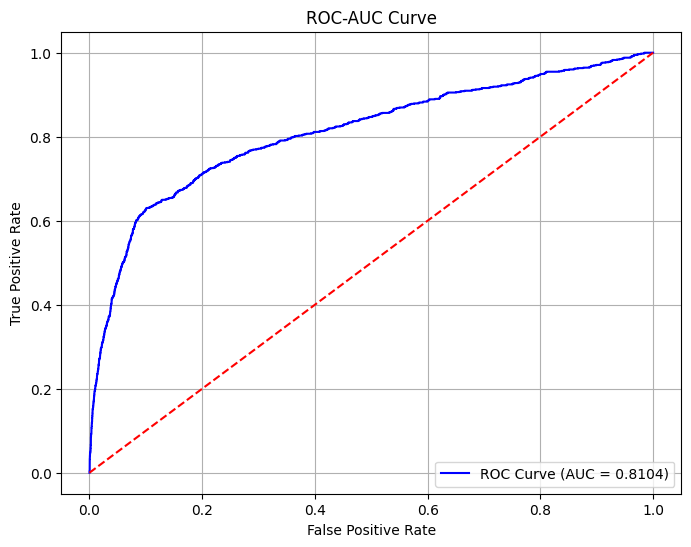

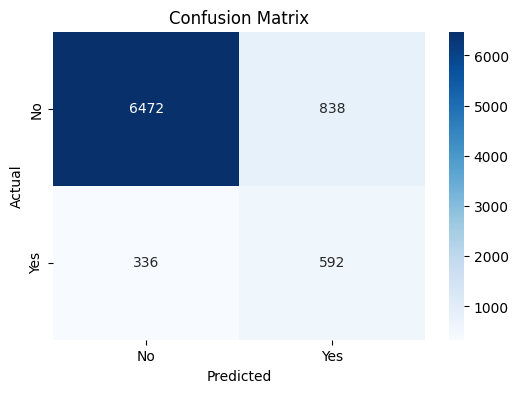

In [149]:
# Evaluate Model Performance
def evaluate_model_performance(model, X_test, y_test):
    y_pred = model.predict(X_test)
    y_pred_prob = (
        model.predict_proba(X_test)[:, 1] if hasattr(model, "predict_proba") else None
    )

    # Metrics
    recall = recall_score(y_test, y_pred, pos_label=1)
    precision = precision_score(y_test, y_pred, pos_label=1)
    accuracy = accuracy_score(y_test, y_pred)
    roc_auc = roc_auc_score(y_test, y_pred_prob) if y_pred_prob is not None else None

    print("\nClassification Report:\n")
    print(classification_report(y_test, y_pred))

    print(f"Recall: {recall:.4f}")
    print(f"Precision: {precision:.4f}")
    print(f"Accuracy: {accuracy:.4f}")
    if roc_auc:
        print(f"ROC-AUC: {roc_auc:.4f}")

    # Create Charts and Graphs
    plot_roc_auc_curve(y_test, y_pred_prob) if roc_auc else None
    plot_confusion_matrix(y_test, y_pred)

    return recall, precision, accuracy, roc_auc


# Plot ROC-AUC Curve
def plot_roc_auc_curve(y_test, y_pred_prob):
    fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)
    plt.figure(figsize=(8, 6))
    plt.plot(
        fpr,
        tpr,
        color="blue",
        label=f"ROC Curve (AUC = {roc_auc_score(y_test, y_pred_prob):.4f})",
    )
    plt.plot([0, 1], [0, 1], color="red", linestyle="--")
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.title("ROC-AUC Curve")
    plt.legend(loc="lower right")
    plt.grid()
    plt.show()


# Plot Confusion Matrix
def plot_confusion_matrix(y_test, y_pred):
    from sklearn.metrics import confusion_matrix

    cm = confusion_matrix(y_test, y_pred)
    plt.figure(figsize=(6, 4))
    sns.heatmap(
        cm,
        annot=True,
        fmt="d",
        cmap="Blues",
        xticklabels=["No", "Yes"],
        yticklabels=["No", "Yes"],
    )
    plt.xlabel("Predicted")
    plt.ylabel("Actual")
    plt.title("Confusion Matrix")
    plt.show()


model = RandomForestClassifier(
    **results_df2.loc[results_df2["Model"] == "random_forest 1"]["Best Params"].values[
        0
    ]
)
model.fit(X_train, y_train)
# Example Usage
recall_test, precision_test, accuracy_test, roc_auc_test = evaluate_model_performance(
    model=model, X_test=X_test, y_test=y_test
)

# Modelling with df_cut_7

In [131]:
# features to drop
drop_features = [
    # "age",
    "pdays",
    "pdays_numeric",
    "pdays_med_impute",
    # "duration",
    "y",
    # "nr.employed",
    # "emp.var.rate",
    # "default",
    # "age_binned",
    # "pdays_binned",
]
potential_drop = ["month", "day_of_week"]
X = df_cut_7.copy()
X = df_cut_7.drop(columns=drop_features)
X["previous"] = X["previous"].astype(int)
y = df_cut_7.y
scale_cols = [
    "pdays_knn_impute",
    "cons.price.idx",
    "campaign",
    "cons.conf.idx",
    "age",
    "previous",
]
scaler = StandardScaler()
X[scale_cols] = pd.DataFrame(scaler.fit_transform(X[scale_cols]), columns=scale_cols)
# Train-test split with stratified sampling
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, stratify=y, random_state=42
)


# Models with imbalance handling
models = {
    "logistic_regression": LogisticRegression(random_state=42, class_weight="balanced"),
    "random_forest": RandomForestClassifier(
        random_state=42, n_jobs=-1, warm_start=True
    ),
    "xgboost": XGBClassifier(
        objective="binary:logistic",
        random_state=42,
        use_label_encoder=False,
        eval_metric="logloss",
        scale_pos_weight=len(y_train[y_train == 0]) / len(y_train[y_train == 1]),
        n_jobs=-1,
    ),
    "naive_bayes": GaussianNB(),
    "isolation_forest": IsolationForest(
        random_state=42,
        contamination=len(y_train[y_train == 1]) / len(y_train),
        n_jobs=-1,
    ),
}


mod = "random_forest"

X_train_bf, X_test_bf = X_train.copy(), X_test.copy()

ros = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = ros.fit_resample(X_train_bf, y_train)


feature_importance_dict = {}

for train_x, train_y, df_name in [
    (X_train_bf, y_train, "regular"),
    (X_train_resampled, y_train_resampled, "oversample"),
]:
    # Feature selection
    print(f"\n--- Feature Selection with {mod} ---")
    top_features, top_features_reduced, important_features, model = select_features(
        models[mod], train_x, train_y, list(X_train.columns)
    )
    feature_importance_dict[df_name] = [
        important_features,
        top_features,
        top_features_reduced,
    ]


--- Feature Selection with random_forest ---
Top 59 Features:
                             Feature  Importance
55                        econ_feat    0.138325
0                               age    0.129056
1                          campaign    0.065000
58                 pdays_knn_impute    0.059746
4                     cons.conf.idx    0.038675
29                      housing_yes    0.037943
3                    cons.price.idx    0.032691
51       pdays_binned_Not Contacted    0.023890
31                         loan_yes    0.023735
57                    pdays_missing    0.020566
16                  marital_married    0.019632
52  age_binned_Early Adults (31-45)    0.017081
24      education_university.degree    0.017015
13                   job_technician    0.016999
21            education_high.school    0.016957
45                  day_of_week_wed    0.016943
2                          previous    0.016797
43                  day_of_week_thu    0.016601
42                  day_

Training Recall: 0.9609
Training Precision: 0.9946
              precision    recall  f1-score   support

           0       0.99      1.00      1.00     27874
           1       0.99      0.96      0.98      3654

    accuracy                           0.99     31528
   macro avg       0.99      0.98      0.99     31528
weighted avg       0.99      0.99      0.99     31528

32 Selected Features: ['econ_feat', 'age', 'campaign', 'pdays_knn_impute', 'cons.conf.idx', 'housing_yes', 'cons.price.idx', 'pdays_binned_Not Contacted', 'loan_yes', 'pdays_missing', 'marital_married', 'age_binned_Early Adults (31-45)', 'education_university.degree', 'job_technician', 'education_high.school', 'day_of_week_wed', 'previous', 'day_of_week_thu', 'day_of_week_mon', 'marital_single', 'day_of_week_tue', 'poutcome_success', 'pdays_binned_Last Week', 'contact_telephone', 'job_blue-collar', 'default_unknown', 'education_basic.9y', 'education_professional.course', 'job_management', 'poutcome_nonexistent', 'j

Training Recall: 0.5550
Training Precision: 0.9988
              precision    recall  f1-score   support

           0       0.69      1.00      0.82     27874
           1       1.00      0.55      0.71     27874

    accuracy                           0.78     55748
   macro avg       0.85      0.78      0.77     55748
weighted avg       0.85      0.78      0.77     55748

32 Selected Features: ['econ_feat', 'age', 'campaign', 'pdays_knn_impute', 'cons.conf.idx', 'housing_yes', 'cons.price.idx', 'pdays_binned_Not Contacted', 'loan_yes', 'pdays_missing', 'marital_married', 'age_binned_Early Adults (31-45)', 'education_university.degree', 'job_technician', 'education_high.school', 'day_of_week_wed', 'previous', 'day_of_week_thu', 'day_of_week_mon', 'marital_single', 'day_of_week_tue', 'poutcome_success', 'pdays_binned_Last Week', 'contact_telephone', 'job_blue-collar', 'default_unknown', 'education_basic.9y', 'education_professional.course', 'job_management', 'poutcome_nonexistent', 'j

In [133]:
from sklearn.model_selection import RandomizedSearchCV

# Cross-validation strategy


cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)


# # Grid search and evaluation


best_models2 = {}


results2 = []


for train_x, train_y, df_name in [
    (X_train_bf, y_train, "regular"),
    (X_train_resampled, y_train_resampled, "oversample"),
]:

    for feature_list in [
        feature_importance_dict[df_name][1],
        feature_importance_dict[df_name][2],
    ]:

        for name, model in models.items():

            print(f"\nTraining {name}...")

            best_recall = 0

            param_grid = param_grids.get(name, {})

            # Perform grid search for models

            if name == "isolation_forest":

                for params in ParameterGrid(param_grid):

                    model.fit(train_x)

                    # Predictions for train and test

                    y_pred_train = model.predict(train_x)

                    y_pred_test = model.predict(X_test_bf)

                    # Convert predictions (-1: anomaly, 1: inlier) to binary labels (1: yes, 0: no)

                    y_pred_train = (y_pred_train == -1).astype(int)

                    y_pred_test = (y_pred_test == -1).astype(int)

                    # Evaluate on training data

                    recall_train = recall_score(train_y, y_pred_train, pos_label=1)

                    precision_train = precision_score(
                        train_y, y_pred_train, pos_label=1
                    )

                    # Evaluate on test data

                    recall_test = recall_score(y_test, y_pred_test, pos_label=1)

                    precision_test = precision_score(y_test, y_pred_test, pos_label=1)

                    # Update best model based on recall

                    if recall_test > best_recall:

                        best_models2[name] = best_model

                        best_params = params

            else:

                grid = RandomizedSearchCV(
                    estimator=model,
                    param_distributions=param_grid,
                    scoring="recall",  # Focus on recall
                    cv=cv,
                    n_jobs=-1,
                    verbose=1,
                )

                grid.fit(train_x, train_y)

                print(f"Best parameters for {name}: {grid.best_params_}")

                best_model = grid.best_estimator_

                best_models2[name] = best_model

                y_pred_train = best_model.predict(train_x)

                y_pred_test = best_model.predict(X_test_bf)

            # Evaluate on training data

            recall_train = recall_score(train_y, y_pred_train, pos_label=1)

            precision_train = precision_score(train_y, y_pred_train, pos_label=1)

            f1_train = f1_score(train_y, y_pred_train, pos_label=1)

            accuracy_train = accuracy_score(train_y, y_pred_train)

            print(classification_report(train_y, y_pred_train))

            # Evaluate on test data

            recall_test = recall_score(y_test, y_pred_test, pos_label=1)

            precision_test = precision_score(y_test, y_pred_test, pos_label=1)

            f1_test = f1_score(y_test, y_pred_test, pos_label=1)

            accuracy_test = accuracy_score(y_test, y_pred_test)

            print(classification_report(y_test, y_pred_test))

            # Save results

            results2.append(
                {
                    "Model": name,
                    "Best Params": (
                        grid.best_params_ if name != "isolation_forest" else best_params
                    ),
                    "Train Recall": recall_train,
                    "Train Precision": precision_train,
                    "Train F1": f1_train,
                    "Train Accuracy": accuracy_train,
                    "Test Recall": recall_test,
                    "Test Precision": precision_test,
                    "Test F1": f1_test,
                    "Test Accuracy": accuracy_test,
                    "Data Type": df_name,
                    "Feature Length": len(feature_list),
                }
            )


# Convert results to a DataFrame


results_df4 = pd.DataFrame(results2)


Training logistic_regression...
Fitting 5 folds for each of 10 candidates, totalling 50 fits
Best parameters for logistic_regression: {'solver': 'liblinear', 'penalty': 'l2', 'class_weight': 'balanced', 'C': 0.01}
              precision    recall  f1-score   support

           0       0.95      0.83      0.88     27874
           1       0.33      0.65      0.44      3654

    accuracy                           0.81     31528
   macro avg       0.64      0.74      0.66     31528
weighted avg       0.88      0.81      0.83     31528

              precision    recall  f1-score   support

           0       0.95      0.83      0.89      6970
           1       0.34      0.66      0.45       913

    accuracy                           0.81      7883
   macro avg       0.64      0.75      0.67      7883
weighted avg       0.88      0.81      0.84      7883


Training random_forest...
Fitting 5 folds for each of 10 candidates, totalling 50 fits
Best parameters for random_forest: {'n_esti

In [174]:
results_df4 = pd.DataFrame(results2)
results_df4["Model"] = results_df4["Model"] + " " + results_df4.index.astype(str)

results_df4.to_csv("model_results_cut_7.csv")
results_df4[
    [
        "Model",
        "Test Recall",
        "Test Precision",
        "Test F1",
        "Test Accuracy",
        "Data Type",
        "Feature Length",
    ]
].loc[results_df4["Feature Length"] == 32].sort_values("Test Recall", ascending=False)

,Model,Test Recall,Test Precision,Test F1,Test Accuracy,Data Type,Feature Length
16,random_forest 16,0.955093,0.129859,0.228631,0.253584,oversample,32
17,xgboost 17,0.918949,0.139461,0.242171,0.333883,oversample,32
7,xgboost 7,0.767798,0.226861,0.350237,0.670049,regular,32
5,logistic_regression 5,0.658269,0.340510,0.448842,0.812762,regular,32
6,random_forest 6,0.652793,0.401077,0.496874,0.846886,regular,32
18,naive_bayes 18,0.565170,0.271008,0.366347,0.773563,oversample,32
15,logistic_regression 15,0.480832,0.297023,0.367210,0.808068,oversample,32
8,naive_bayes 8,0.465498,0.475391,0.470393,0.878600,regular,32
9,isolation_forest 9,0.385542,0.364767,0.374867,0.851072,regular,32
19,isolation_forest 19,0.319825,0.328459,0.324084,0.845490,oversample,32



Classification Report:

              precision    recall  f1-score   support

           0       0.95      0.87      0.91      6970
           1       0.40      0.65      0.50       913

    accuracy                           0.85      7883
   macro avg       0.67      0.76      0.70      7883
weighted avg       0.89      0.85      0.86      7883

Recall: 0.6528
Precision: 0.3987
Accuracy: 0.8457
ROC-AUC: 0.8063


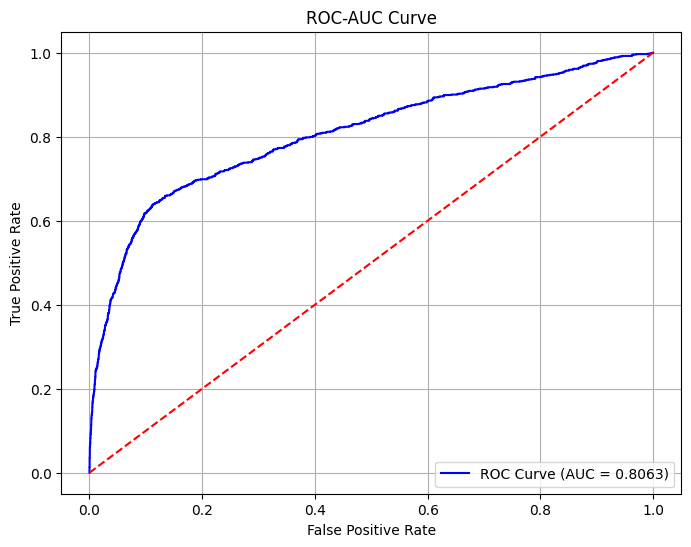

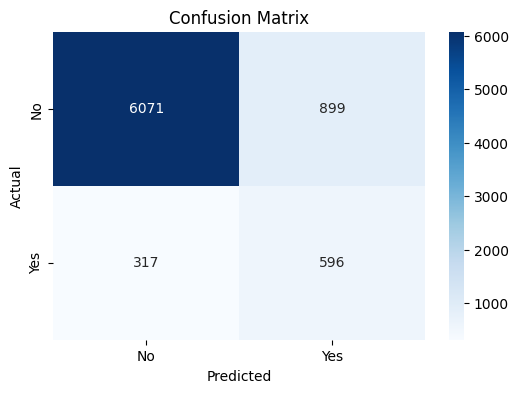

In [167]:
# features to drop
drop_features = [
    # "age",
    "pdays",
    "pdays_numeric",
    "pdays_med_impute",
    # "duration",
    "y",
    # "nr.employed",
    # "emp.var.rate",
    # "default",
    # "age_binned",
    # "pdays_binned",
]
potential_drop = ["month", "day_of_week"]
X = df_cut_7.copy()
X = df_cut_7.drop(columns=drop_features)
X["previous"] = X["previous"].astype(int)
y = df_cut_7.y
scale_cols = [
    "pdays_knn_impute",
    "cons.price.idx",
    "campaign",
    "cons.conf.idx",
    "age",
    "previous",
]

X = X[top_features_reduced]

scaler = StandardScaler()
X[scale_cols] = pd.DataFrame(scaler.fit_transform(X[scale_cols]), columns=scale_cols)
# Train-test split with stratified sampling
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, stratify=y, random_state=42
)

model = RandomForestClassifier(
    **results_df4.loc[results_df4["Model"] == "random_forest 6"]["Best Params"].values[
        0
    ]
)
model.fit(X_train, y_train)
# Example Usage
recall_test, precision_test, accuracy_test, roc_auc_test = evaluate_model_performance(
    model=model, X_test=X_test, y_test=y_test
)

In [175]:
results_df4.loc[results_df4["Model"] == "xgboost 17"]["Best Params"].values[0]

{'subsample': 0.8,
 'scale_pos_weight': 15,
 'n_estimators': 200,
 'max_depth': 3,
 'learning_rate': 0.1,
 'colsample_bytree': 0.8}

Removing clients contacted more than 7 times (df_cut_7) improved recall from 63% to  65.3%, however, there was a  slight dip in precision and F1-score. The model trained on the full dataset had a better balance between recall and precision, with the highest F1-score (50.21%)and accuracy  (86%). Since our focus is minimizing If minimizing false negatives the model random_forest 6 on df_cut_7 is the best choice. 



In [198]:
# Define the base models
base_models = [
    (
        "logistic",
        LogisticRegression(
            random_state=42,
            **{
                "solver": "liblinear",
                "penalty": "l2",
                "class_weight": "balanced",
                "C": 0.01,
            }
        ),
    ),
    (
        "random_forest",
        RandomForestClassifier(
            random_state=42,
            **{
                "n_estimators": 100,
                "min_samples_split": 2,
                "min_samples_leaf": 4,
                "max_depth": 10,
                "class_weight": {0: 1, 1: 8},
            }
        ),
    ),
    ("naive_bayes", GaussianNB()),
]

# Define the meta-model
meta_model = LogisticRegression(random_state=42, class_weight="balanced")

# Create the stacked classifier
stacked_model = StackingClassifier(
    estimators=base_models, final_estimator=meta_model, cv=5, n_jobs=-1
)

X = X[top_features_reduced]


# Train-test split (assuming X and y are already defined)
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, stratify=y, random_state=42
)

# Train the stacked model
stacked_model.fit(X_train, y_train)

# Make predictions
y_pred = stacked_model.predict(X_test)

# Evaluate the stacked model
print("Stacked Model Performance:")
print(classification_report(y_test, y_pred))

Stacked Model Performance:
              precision    recall  f1-score   support

           0       0.95      0.84      0.89      6970
           1       0.35      0.68      0.46       913

    accuracy                           0.82      7883
   macro avg       0.65      0.76      0.68      7883
weighted avg       0.88      0.82      0.84      7883




Classification Report:

              precision    recall  f1-score   support

           0       0.95      0.84      0.89      6970
           1       0.35      0.68      0.46       913

    accuracy                           0.82      7883
   macro avg       0.65      0.76      0.68      7883
weighted avg       0.88      0.82      0.84      7883

Recall: 0.6758
Precision: 0.3510
Accuracy: 0.8177
ROC-AUC: 0.8059


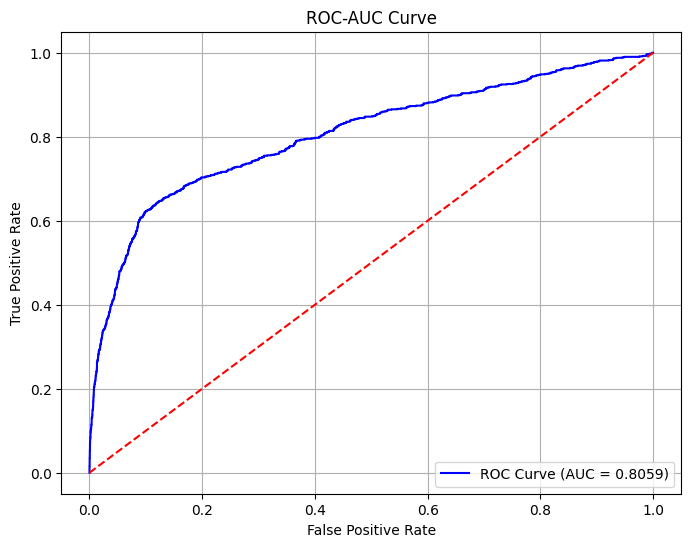

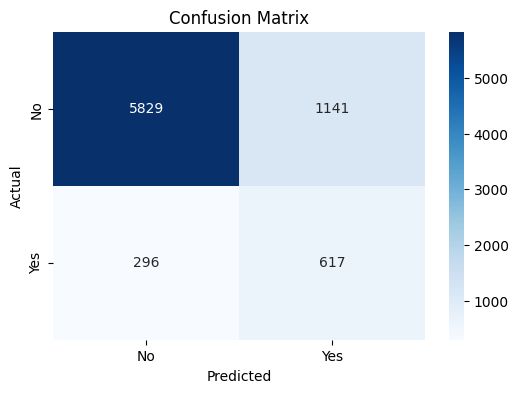

In [199]:
recall_test, precision_test, accuracy_test, roc_auc_test = evaluate_model_performance(
    model=stacked_model, X_test=X_test, y_test=y_test
)

The above stacked model performed slightly poorer than the best single model. 

# Assessment Questions

2. Once your model is built, think about how you’d deploy it in production, which technologies you’d use?   
    
    I would build production-level code for my model using sklearn.compose to create an ML pipeline that includes preprocessing, feature engineering, and model training steps. The pipeline would be containerized with Docker and deployed to Azure Kubernetes Service (AKS) for scalability and resilience, with auto-scaling enabled to handle growing workloads. The deployment process would be automated using GitLab CI/CD, ensuring smooth updates and rollback capabilities.

    For monitoring, I would track prediction drift, data drift, and target drift, set performance thresholds, and implement alerts for anomalies. I’d also monitor system performance (latency, resource usage) and set up retraining pipelines triggered by drift or performance degradation. Using tools like Azure Monitoring, I would ensure ongoing model performance meets business requirements, and alerts notify stakeholders if issues arise. The model would be deployed as an API, allowing seamless integration into a website, dashboards, or email.

3. How the marketing team can use/consume your model?  
    
    I believe the marketing can leverage this model through an integrated architecture that monitors the client database and dynamically identifies high-priority clients for contact. During a campaign, the model would generate a daily subset of clients with a high likelihood of subscription conversion. This list could be delivered via automated emails or integrated into a dedicated app or dashboard, where agents can view and prioritize their calls.  


4. How do you decide when your model needs to be refreshed/retrained?
    
    There are 3 key metrics that I would be monitoring in order to determine if the model needs a refresh or retraining. Those are prediction drift, data drift, and target drift.  If thresholds for these metrics are exceeded, alerts are triggered to evaluate or retrain the model. For time-dependent features like economic variables, regular retraining is scheduled (e.g., monthly or quarterly) to account for changing trends. Performance metrics like precision, recall, or AUC are also monitored in production, and significant degradation beyond acceptable level signals the need for a model refresh.


5. What other data sources you think can help improve your model?  

    •  Demographic Information: Client income, family size, and geographic location could help identify financial priorities and constraints.  
    •  Service Familiarity: Information about the client’s familiarity with the services being offered, including prior usage or subscriptions at other institutions, could provide context for their likelihood of subscribing.  
    •  Client Sentiment: Data on the client’s perception of the financial institution, such as survey responses, social media sentiment, or customer feedback, could help uncover clients’ trust and satisfaction levels.  
    •  Competitor Analysis: Insights into whether clients are subscribed to similar services at other institutions and how those services compare.  
    Transaction Data: Data on spending patterns to identify clients who are more likely to be subscribers.  
